## 臉部偵測與辨識

In [1]:
# 起手式
import sys,  time
import ipywidgets as widget
from ipywidgets import interact
from IPython.display import display
import numpy as np
import cv2
from PIL import Image
from io import BytesIO
def to_pil(ima):
    if ima.dtype == np.float64:
        ima = (ima*255).clip(0,255).astype('uint8')
    return Image.fromarray(ima)
    
def img_to_png(ima, cvt=None):
    if cvt:
        ima = cv2.cvtColor(ima, cvt)
    im = to_pil(ima)
    bio = BytesIO()
    im.save(bio, format='png')
    return bio.getvalue()

In [2]:
# 讀取已經學習過的臉部以及眼睛偵測 haar cascade
face_cascade = cv2.CascadeClassifier('haarcascades/haarcascade_frontalface_default.xml')
eye_cascade = cv2.CascadeClassifier('haarcascades/haarcascade_eye.xml')

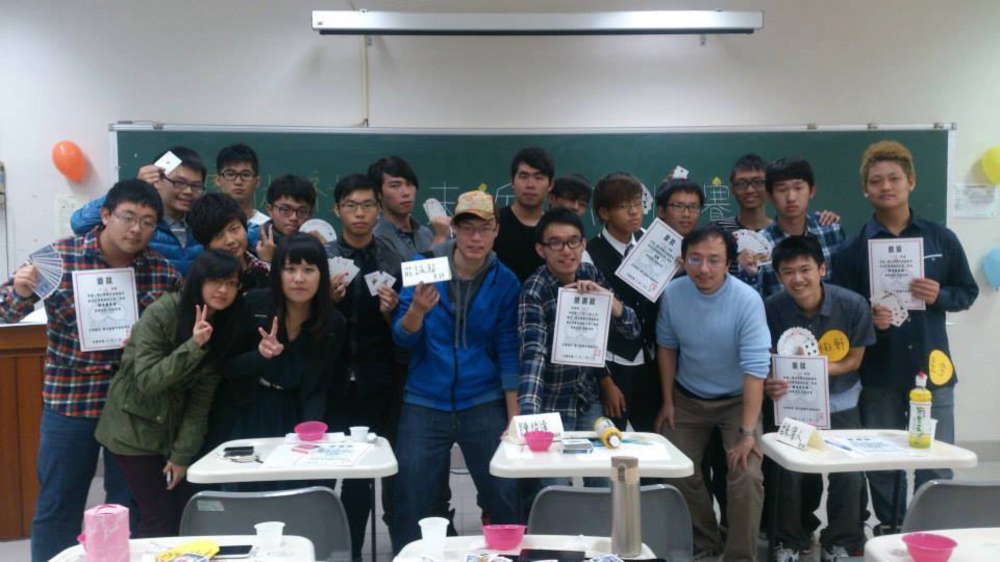

In [3]:
# 東華魔術社近距離比賽照片
img = Image.open("img/magic_faces.jpg")
# 轉成陣列
img = np.array(img)
# 放大兩倍，比較好找
img = cv2.resize(img, (img.shape[1]*2, img.shape[0]*2))
# 灰階圖
gray = cv2.cvtColor(img, cv2.COLOR_RGB2GRAY)
# 顯示
to_pil(img)

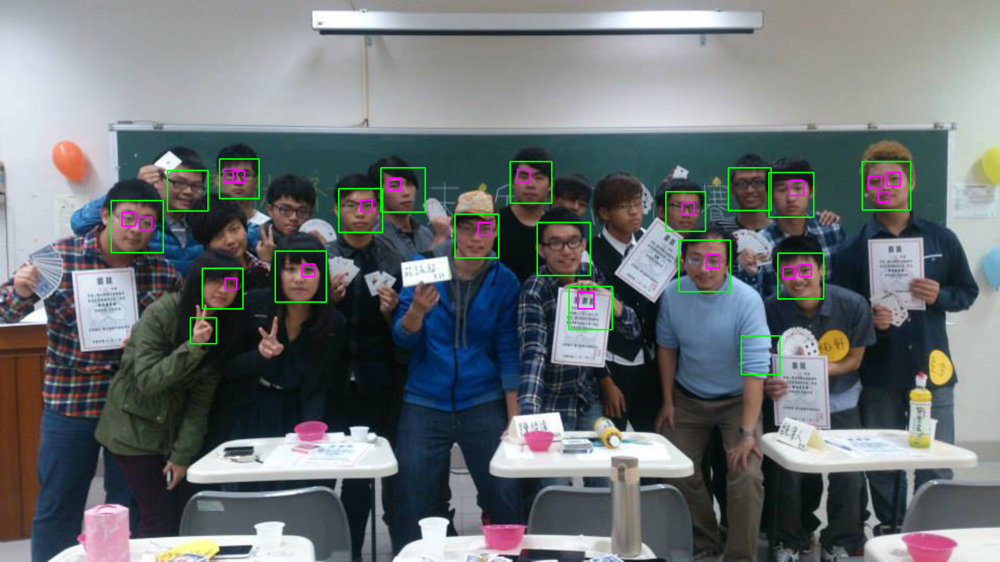

In [4]:
# 從裡面來找找看臉吧
faces = face_cascade.detectMultiScale(gray, 1.1, 5)
# 從每個找到的裡面，再去找眼睛
for (x,y,w,h) in faces:
    # 畫綠色的長方形
    cv2.rectangle(img,(x,y),(x+w,y+h),(0,255,0),2)
    # 專注在臉部的小長方形圖
    roi_gray = gray[y:y+h, x:x+w]
    roi_color = img[y:y+h, x:x+w]
    # 從小長方形灰階圖中間去找眼睛
    eyes = eye_cascade.detectMultiScale(roi_gray)
    # 畫出眼睛的方塊
    for (ex,ey,ew,eh) in eyes:
        cv2.rectangle(roi_color,(ex,ey),(ex+ew,ey+eh),(255,0,255),2)
to_pil(img)

In [5]:
# 另外一種臉部偵測方式，使用 dlib
import dlib
fd = dlib.get_frontal_face_detector()


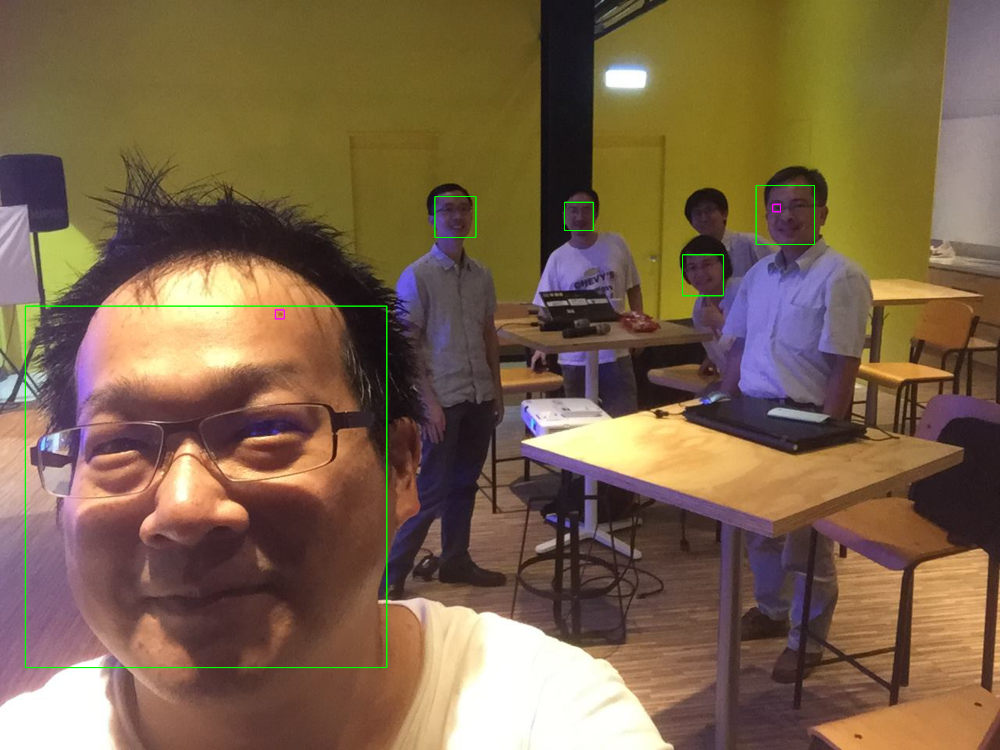

In [6]:
def find_faces(fn):
    img = Image.open(fn)
    img = np.array(img)
    img = cv2.resize(img, (img.shape[1]*2, img.shape[0]*2))
    #img = cv2.resize(img, (200,400))
    rl = fd(img)
    gray = cv2.cvtColor(img, cv2.COLOR_RGB2GRAY)
    #faces = face_cascade.detectMultiScale(gray, 1.1, 5, minSize=(5,5), maxSize=(1000,1000))
    #for (x,y,w,h) in faces:
    for r in rl:
        x,y,w,h = r.left(), r.top(), r.width(), r.height()
        cv2.rectangle(img,(x,y),(x+w,y+h),(0,255,0),2)
        roi_gray = gray[y:y+h, x:x+w]
        roi_color = img[y:y+h, x:x+w]
        eyes = eye_cascade.detectMultiScale(roi_gray)
        for (ex,ey,ew,eh) in eyes:
            cv2.rectangle(roi_color,(ex,ey),(ex+ew,ey+eh),(255,0,255),2)
    return to_pil(img)
find_faces("img/py_faces.jpg")

# Photo files from https://www.flickr.com/photos/76636751@N06/albums

In [ ]:
#!wget dropbox-url
#!unzip x zipfile
#!ls

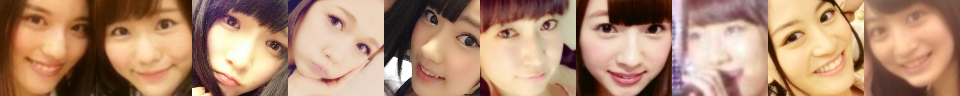

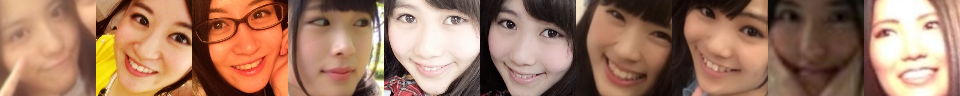

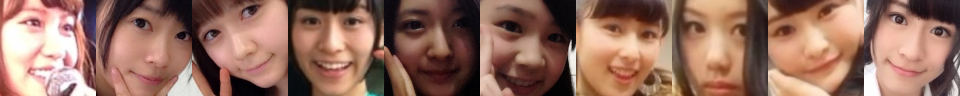

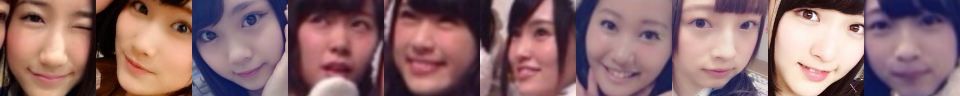

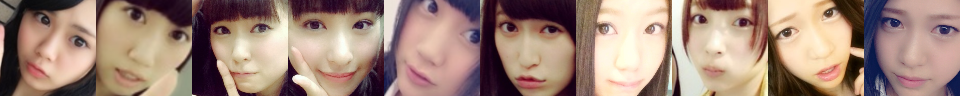

...

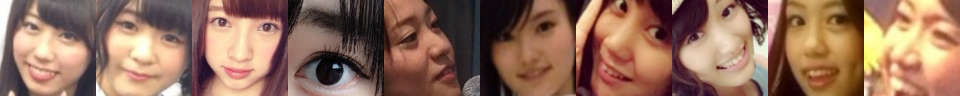

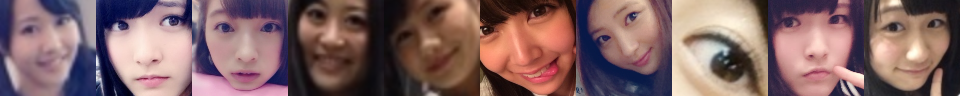

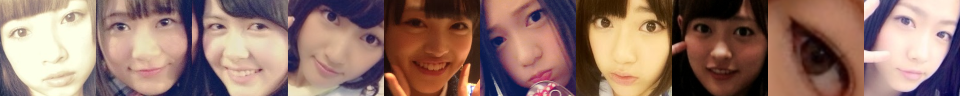

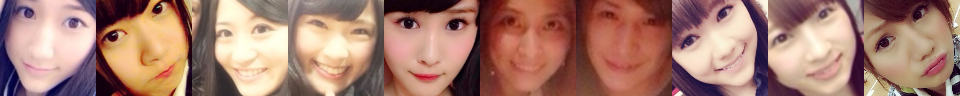

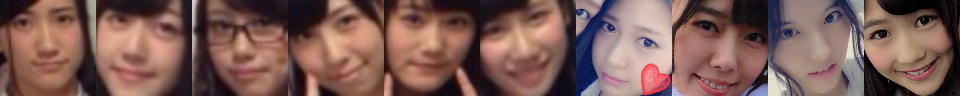

In [44]:
import glob
color_faces = []
gray_faces = []
for fn in glob.glob("akb48/*.jpg"):
    img = Image.open(fn)
    img = np.array(img)
    img0 = img = cv2.resize(img, (img.shape[1]*2, img.shape[0]*2))
    #rows,cols = img0.shape[:2]
    #for deg in range(-45, 46, 45):
    #    M = cv2.getRotationMatrix2D((cols/2,rows/2),deg,1)
    #    img = cv2.warpAffine(img0,M,(cols,rows))
    if 1:
        gray = cv2.cvtColor(img, cv2.COLOR_RGB2GRAY)
        #faces = face_cascade.detectMultiScale(gray, 1.3, 5)
        #for (x,y,w,h) in faces:
        rl = fd(img)
        for r in rl:
            x,y,w,h = r.left(), r.top(), r.width(), r.height()
            if x<0 or y <0:
                continue
            roi_color = cv2.resize(img[y:y+h, x:x+w], (96,96))
            roi_gray = cv2.cvtColor(roi_color, cv2.COLOR_RGB2GRAY)
            roi_gray = cv2.equalizeHist(roi_gray)
            color_faces.append(roi_color.copy())
            gray_faces.append(roi_gray)
            if len(color_faces)%10 == 0:
                out_img = np.concatenate(color_faces[-10:], axis=1)
                display(to_pil(out_img))
        #display(to_pil(roi_gray))


In [45]:
idx=np.arange(len(gray_faces))
np.random.shuffle(idx)
gray_faces = np.array(gray_faces)
color_faces = np.array(color_faces)
gray_faces=gray_faces[idx]
color_faces=color_faces[idx]

In [46]:
model = cv2.face.createLBPHFaceRecognizer()

In [47]:
labels=np.arange(len(gray_faces)-100)

In [48]:
model.train(gray_faces[:-100], labels)

(395, 103.11456492754894)


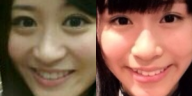

(501, 121.21738981567813)


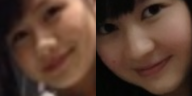

(60, 96.25339833837563)


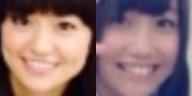

(53, 103.16472680760714)


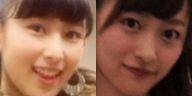

(59, 104.47876192136489)


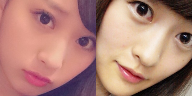

(381, 108.51908005607939)


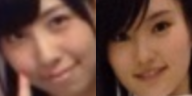

(291, 114.9375181729753)


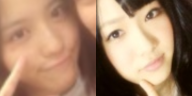

(197, 85.15775315850267)


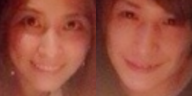

(364, 98.03063605348095)


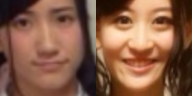

(507, 113.94750304060236)


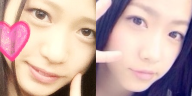

(258, 109.66689249937266)


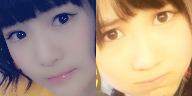

(115, 107.87868839735224)


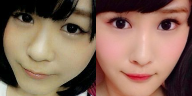

(226, 104.38666703842463)


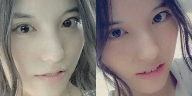

(508, 110.03763627527563)


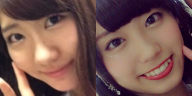

(172, 112.9053261300292)


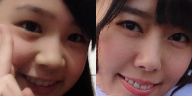

(486, 111.28554060460345)


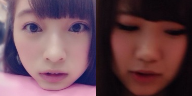

(337, 104.31617943040567)


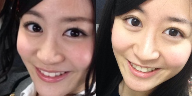

(492, 105.4079183105679)


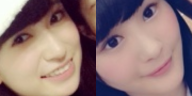

(372, 111.65901989815696)


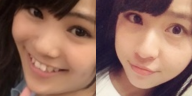

(46, 120.44270017547333)


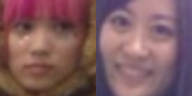

(441, 130.44116506276353)


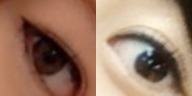

(198, 120.02904969630825)


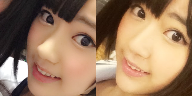

(288, 99.51346193156628)


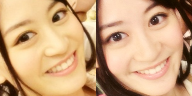

(256, 105.54788019826935)


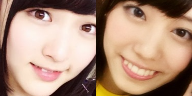

(465, 106.35326019818501)


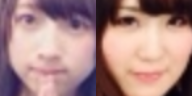

(287, 119.60003096269884)


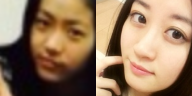

(348, 99.13305121322982)


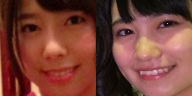

(493, 85.99616292783898)


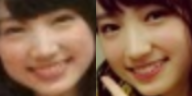

(367, 115.87512498837285)


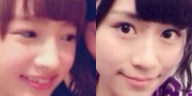

(368, 102.08995409407008)


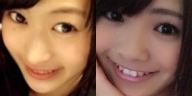

(6, 101.33303628290058)


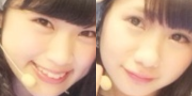

(371, 114.6226950639095)


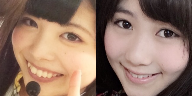

(493, 107.05965923100851)


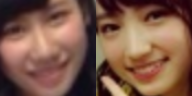

(262, 97.80295051921908)


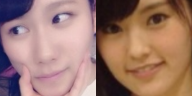

(300, 105.49805766242598)


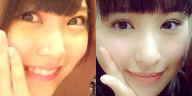

(106, 92.10952492095144)


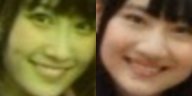

(415, 99.15457903927546)


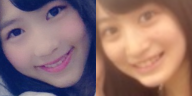

(272, 102.82159954495255)


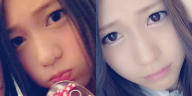

(72, 122.32814888992)


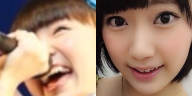

(6, 112.59899402411757)


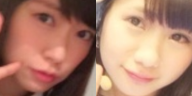

(203, 111.67121946314968)


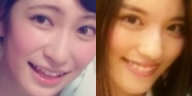

(470, 95.10281589675945)


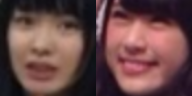

(264, 105.35992230570807)


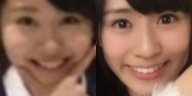

(1, 110.65001323678237)


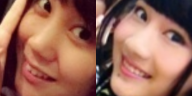

(450, 102.27589620684665)


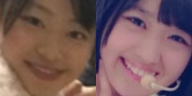

(67, 107.95838435110744)


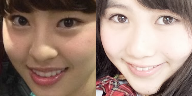

(2, 99.34147057044434)


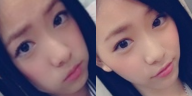

(80, 113.1409592920145)


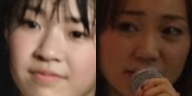

(347, 107.35461125260143)


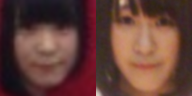

(443, 107.97648079536643)


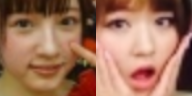

(450, 104.28507288441034)


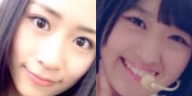

(262, 102.05102141907761)


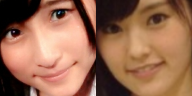

(257, 101.21688846166892)


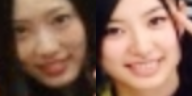

(173, 94.73365975366738)


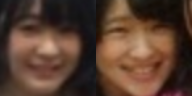

(492, 105.99086669870134)


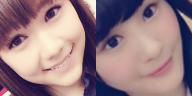

(461, 110.28365655901209)


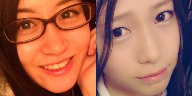

(327, 104.45121020811371)


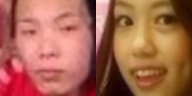

(377, 105.57976919654695)


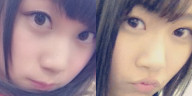

(169, 110.79978350342704)


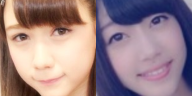

(255, 100.77491525398639)


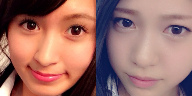

(96, 117.85576718482905)


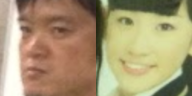

(15, 115.48227980216993)


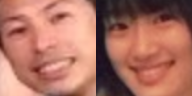

(447, 97.73579537826288)


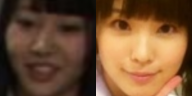

(316, 97.2053806379773)


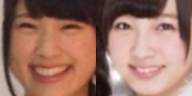

(399, 105.95252324665454)


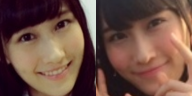

(483, 92.53354479245641)


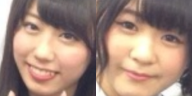

(169, 101.42677920237666)


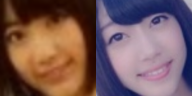

(367, 114.01884641800964)


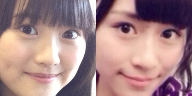

(341, 111.95436747070227)


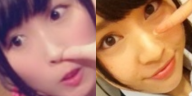

(349, 106.09042945662877)


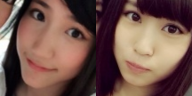

(21, 97.10387340539431)


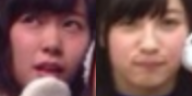

(33, 100.66540889786894)


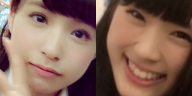

(383, 110.01243456238069)


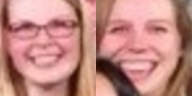

(15, 97.48756073547392)


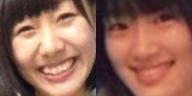

(228, 105.47542416766181)


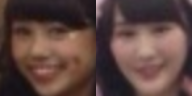

(267, 101.14344667544017)


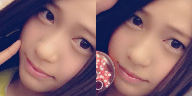

(414, 104.04068760004978)


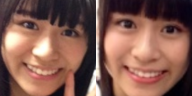

(98, 105.29015680375788)


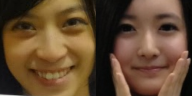

(156, 110.24730895836653)


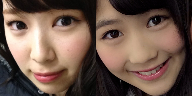

(358, 112.35885657928765)


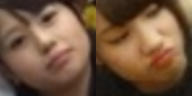

(45, 104.29767349961693)


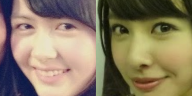

(439, 128.37428695456708)


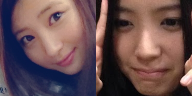

(325, 108.93809043627007)


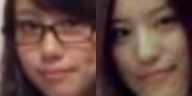

(359, 111.03690259435888)


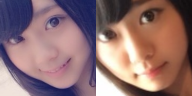

(260, 100.95235731926152)


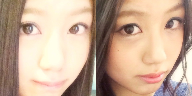

(343, 109.01024254392674)


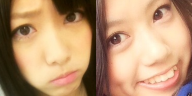

(181, 101.17364010183303)


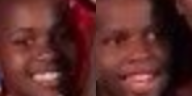

(298, 123.66985510322131)


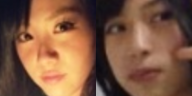

(373, 115.24855221442337)


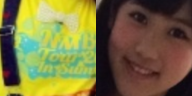

(148, 97.89168197120054)


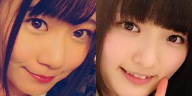

(486, 109.28228361091514)


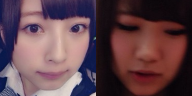

(279, 97.11975505631663)


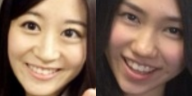

(15, 102.01455563453472)


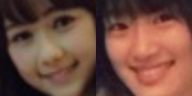

(317, 80.66029347579827)


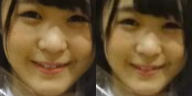

(76, 113.03722955122083)


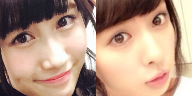

(214, 105.00951235179981)


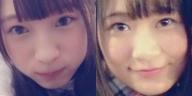

(385, 115.62112949642821)


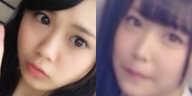

(447, 99.46100069521903)


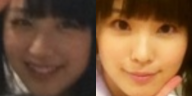

(367, 106.30353472017458)


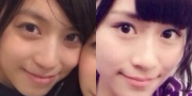

(438, 98.46989975557699)


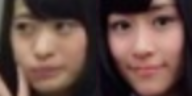

In [49]:
for i in range(100):
    r = model.predict(gray_faces[-i-1])
    print(r)
    img1 = color_faces[-i-1]
    img2 = color_faces[r[0]]
    display(to_pil(np.concatenate([img1, img2], axis=1)))